1. 连续动力学系统（CTDS）与离散动力学系统（DTDS）

首先定义一个单摆系统，其连续时间动力学系统（CTDS）公式如下：

$$
\begin{aligned}
&\text{状态变量：} \quad x = \begin{bmatrix} \theta \\ \dot{\theta} \end{bmatrix} \\
&\text{动力学方程：} \quad \dot{x} = f_0(x) + G(x)u \\
&\text{其中：} \\
&\quad f_0(x) = \begin{bmatrix} \dot{\theta} \\ -\frac{g}{l} \sin(\theta) \end{bmatrix}, \quad G(x) = \begin{bmatrix} 0 \\ \frac{1}{ml^2} \end{bmatrix}, \quad u = \tau
\end{aligned}
$$

其中，$\theta$ 为摆角，$\dot{\theta}$ 为角速度，$g$ 为重力加速度，$l$ 为摆长，$m$ 为摆质量，$\tau$ 为控制输入（外力矩）。

In [1]:
!pip install --upgrade "jax[cuda12_pip]"
!pip install matplotlib

In [2]:
import jax
import jax.numpy as jnp

def pendulum_dynamics(x, u, g=9.81, l=1.0, m=1.0):
    theta, theta_dot = x
    f0 = jnp.array([theta_dot, -g / l * jnp.sin(theta)])
    G = jnp.array([0.0, 1.0 / (m * l ** 2)])
    dxdt = f0 + G * u
    return dxdt

In [3]:
from IPython.display import HTML
from matplotlib import animation, pyplot as plt
import numpy as np

plt.rcParams['font.family'] = 'SimHei'

def animate_pendulum(states, l=1.0, total_time=1.0, subsample=5):
    """
    快速动画绘制单摆
    states: 状态数组
    l: 摆长
    total_time: 总动画时长（秒）
    subsample: 抽样率，每subsample帧取一帧
    """
    # 数据抽样以减少帧数
    states = states[::subsample]
    
    thetas = states[:, 0]
    x = l * np.sin(thetas)
    y = -l * np.cos(thetas)

    fig, ax = plt.subplots(figsize=(4, 4))
    ax.set_xlim(-l-0.2, l+0.2)
    ax.set_ylim(-l-0.2, l+0.2)
    ax.set_aspect('equal')
    ax.set_title('单摆运动')
    
    # 只绘制摆杆和质点，去掉轨迹线以提高性能
    line, = ax.plot([], [], 'o-', lw=2, markersize=8)

    def update(i):
        line.set_data([0, x[i]], [0, y[i]])
        return line,

    # 计算间隔时间以达到目标总时长
    interval = int(total_time * 1000 / len(states))
    
    ani = animation.FuncAnimation(fig, update, frames=len(states),
                                  blit=True, interval=interval, repeat=True)
    plt.close(fig)
    return HTML(ani.to_jshtml())

In [4]:
def test_animate_pendulum():
    # 生成一个简单的单摆状态序列：theta从pi/6到-pi/6往返，theta_dot为0
    N = 40
    thetas = jnp.linspace(jnp.pi/6, -jnp.pi/6, N)
    theta_dots = jnp.zeros(N)
    states = jnp.stack([thetas, theta_dots], axis=1)
    return animate_pendulum(states)
test_animate_pendulum()

C:\Users\lvxiangyu11\AppData\Local\Temp\ipykernel_4332\2817542857.py:38: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) SimHei.
  ani = animation.FuncAnimation(fig, update, frames=len(states),
C:\Users\lvxiangyu11\AppData\Local\Temp\ipykernel_4332\2817542857.py:41: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) SimHei.
  return HTML(ani.to_jshtml())


## 1.1 FEM 正向欧拉法 
这里我们使用最简单的正向欧拉法来展示这这个单摆，并设置初始 $\theta_0=\frac{\pi}{6}$

In [5]:
def simulate_pendulum_fem(x0, u_func, steps=1000, h=0.01, g=9.81, l=1.0, m=1.0):
    """
    用正向欧拉法（FEM）模拟单摆系统
    x0: 初始状态 [theta, theta_dot]
    u_func: 控制输入函数，u = u_func(t, x)
    steps: 仿真步数
    h: 步长
    返回: 所有状态组成的数组 (steps+1, 2)
    """
    states = [jnp.array(x0)]
    x = jnp.array(x0)
    for i in range(steps):
        t = i * h
        u = u_func(t, x)
        dxdt = pendulum_dynamics(x, u, g=g, l=l, m=m)
        x = x + h * dxdt
        states.append(x)
    return jnp.stack(states)

In [6]:
# 定义初始状态和控制输入函数
x0 = [jnp.pi/6, 0.0]
u_func = lambda t, x: 0.0  # 无外力

# 仿真
states = simulate_pendulum_fem(x0, u_func, steps=4000, h=0.01)

# 可视化
animate_pendulum(states)


C:\Users\lvxiangyu11\AppData\Local\Temp\ipykernel_4332\2817542857.py:38: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) SimHei.
  ani = animation.FuncAnimation(fig, update, frames=len(states),
C:\Users\lvxiangyu11\AppData\Local\Temp\ipykernel_4332\2817542857.py:41: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) SimHei.
  return HTML(ani.to_jshtml())


## 1.2 RK4 四阶龙格-库塔法

为了获得更高精度的数值解，可以采用四阶龙格-库塔（RK4）方法对单摆系统进行离散化。RK4方法每一步的更新公式如下：

$$
\begin{aligned}
&k_1 = f(x_n, u_n) \\
&k_2 = f\left(x_n + \frac{h}{2}k_1,\, u_{n+\frac{1}{2}}\right) \\
&k_3 = f\left(x_n + \frac{h}{2}k_2,\, u_{n+\frac{1}{2}}\right) \\
&k_4 = f\left(x_n + h k_3,\, u_{n+1}\right) \\
&x_{n+1} = x_n + \frac{h}{6}(k_1 + 2k_2 + 2k_3 + k_4)
\end{aligned}
$$

其中 $f(x, u)$ 为单摆动力学方程，$h$ 为步长。RK4方法相比正向欧拉法具有更高的精度和更好的稳定性。

In [7]:
def simulate_pendulum_rk4(x0, u_func, steps=1000, h=0.01, g=9.81, l=1.0, m=1.0):
    """
    用RK4法模拟单摆系统
    x0: 初始状态 [theta, theta_dot]
    u_func: 控制输入函数，u = u_func(t, x)
    steps: 仿真步数
    h: 步长
    返回: 所有状态组成的数组 (steps+1, 2)
    """
    states = [jnp.array(x0)]
    x = jnp.array(x0)
    for i in range(steps):
        t = i * h
        u1 = u_func(t, x)
        k1 = pendulum_dynamics(x, u1, g=g, l=l, m=m)
        u2 = u_func(t + h/2, x + h/2 * k1)
        k2 = pendulum_dynamics(x + h/2 * k1, u2, g=g, l=l, m=m)
        u3 = u_func(t + h/2, x + h/2 * k2)
        k3 = pendulum_dynamics(x + h/2 * k2, u3, g=g, l=l, m=m)
        u4 = u_func(t + h, x + h * k3)
        k4 = pendulum_dynamics(x + h * k3, u4, g=g, l=l, m=m)
        x = x + h/6 * (k1 + 2*k2 + 2*k3 + k4)
        states.append(x)
    return jnp.stack(states)

# RK4仿真与可视化
states_rk4 = simulate_pendulum_rk4(x0, u_func, steps=4000, h=0.01)
animate_pendulum(states_rk4)

C:\Users\lvxiangyu11\AppData\Local\Temp\ipykernel_4332\2817542857.py:38: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) SimHei.
  ani = animation.FuncAnimation(fig, update, frames=len(states),
C:\Users\lvxiangyu11\AppData\Local\Temp\ipykernel_4332\2817542857.py:41: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) SimHei.
  return HTML(ani.to_jshtml())


## 1.3 BEM 向后欧拉法

向后欧拉法（Backward Euler Method, BEM）是一种隐式的一阶数值积分方法。其更新公式为：

$$
x_{n+1} = x_n + h \cdot f(x_{n+1}, u_{n+1})
$$

与正向欧拉法不同，BEM需要在每一步求解 $x_{n+1}$，通常需要用数值方法（如牛顿迭代）进行求解。BEM方法具有更好的数值稳定性，适用于刚性系统的积分。

在单摆系统中，BEM的离散化步骤为：

1. 给定 $x_n$，预测 $x_{n+1}$（可用$x_n$作为初值）。
2. 迭代求解 $x_{n+1} = x_n + h \cdot f(x_{n+1}, u_{n+1})$，直到收敛。

BEM方法在步长较大或系统刚性较强时，能有效抑制数值发散。

In [8]:
def simulate_pendulum_bem(x0, u_func, steps=1000, h=0.01, g=9.81, l=1.0, m=1.0, tol=1e-8, max_iter=20):
    """
    用向后欧拉法（BEM）模拟单摆系统
    x0: 初始状态 [theta, theta_dot]
    u_func: 控制输入函数，u = u_func(t, x)
    steps: 仿真步数
    h: 步长
    tol: 牛顿迭代收敛阈值
    max_iter: 牛顿迭代最大次数
    返回: 所有状态组成的数组 (steps+1, 2)
    """
    states = [jnp.array(x0)]
    x = jnp.array(x0)
    for i in range(steps):
        t = i * h
        u_next = u_func(t + h, x)
        # 初值预测
        x_next = x
        for _ in range(max_iter):
            f_val = x_next - x - h * pendulum_dynamics(x_next, u_next, g=g, l=l, m=m)
            # 雅可比矩阵近似
            def F(z): return z - x - h * pendulum_dynamics(z, u_next, g=g, l=l, m=m)
            J = jax.jacfwd(F)(x_next)
            delta = jnp.linalg.solve(J, f_val)
            x_next = x_next - delta
            if jnp.linalg.norm(delta) < tol:
                break
        states.append(x_next)
        x = x_next
    return jnp.stack(states)

# BEM仿真与可视化
states_bem = simulate_pendulum_bem(x0, u_func, steps=4000, h=0.01)
animate_pendulum(states_bem)

C:\Users\lvxiangyu11\AppData\Local\Temp\ipykernel_4332\2817542857.py:38: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) SimHei.
  ani = animation.FuncAnimation(fig, update, frames=len(states),
C:\Users\lvxiangyu11\AppData\Local\Temp\ipykernel_4332\2817542857.py:41: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) SimHei.
  return HTML(ani.to_jshtml())


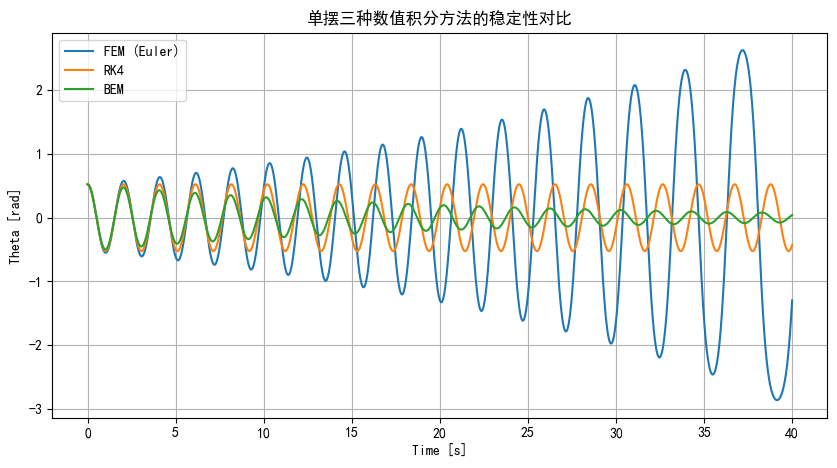

In [9]:
import matplotlib.pyplot as plt
# 添加中文标签
plt.rcParams['font.sans-serif'] = ['SimHei']  # 设置中文字体为黑体
plt.rcParams['axes.unicode_minus'] = False    # 正常显示负号
plt.figure(figsize=(10, 5))
t = jnp.arange(states.shape[0]) * 0.01

plt.plot(t, states[:, 0], label='FEM (Euler)')
plt.plot(t, states_rk4[:, 0], label='RK4')
plt.plot(t, states_bem[:, 0], label='BEM')
plt.xlabel('Time [s]')
plt.ylabel('Theta [rad]')
plt.title('单摆三种数值积分方法的稳定性对比')
plt.legend()
plt.grid(True)
plt.show()